# Cleaning Startracker Images

created: 10th Mar, 2023

Johnny Esteves

## Load Images

Here I copied some coadds images from Merlin. But it's possible to produce them. See Make Stack Exposure section.

In [4]:
from astropy.io import fits
def read_image(filename):
    with fits.open(filename) as hdu:
        imArr = hdu[0].data
    return imArr

In [5]:
ls coadds/

GenericCamera101-20230309-images1352-1512-coadd.fits
GenericCamera102-20230309-images1352-1512-coadd.fits
GenericCamera103-20230309-images1352-1512-coadd.fits


### Visualize Stacked Image

In [6]:
from __future__ import print_function, unicode_literals, absolute_import, division
import sys
import numpy as np
import matplotlib
matplotlib.rcParams["image.interpolation"] = None
import matplotlib.pyplot as plt
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

/tmp/ipykernel_40051/4011289290.py:5: MatplotlibDeprecationWarning: Support for setting an rcParam that expects a str value to a non-str value is deprecated since 3.5 and support will be removed two minor releases later.
  matplotlib.rcParams["image.interpolation"] = None


In [7]:
from scipy.stats import sigmaclip
from mpl_toolkits.axes_grid1 import make_axes_locatable

def display(imArr, nStd = 5, gSig = 7, ax=None):
    if ax is None:
        fig, ax = plt.subplots(1,1, figsize=(12,12))
    imArrClip, low, high = sigmaclip(imArr)
    mean = imArrClip.mean()
    std = imArrClip.std()
    im = ax.imshow(imArr, vmin=mean-nStd*std, vmax=mean+nStd*std, cmap='gray', origin='lower')
    divider = make_axes_locatable(ax)
    cax = divider.append_axes('right', size='5%', pad=0.05)
    plt.colorbar(im, cax=cax, orientation='vertical')
    plt.show()
    cax.cla()
    #fig.savefig('test.png',dpi=125)

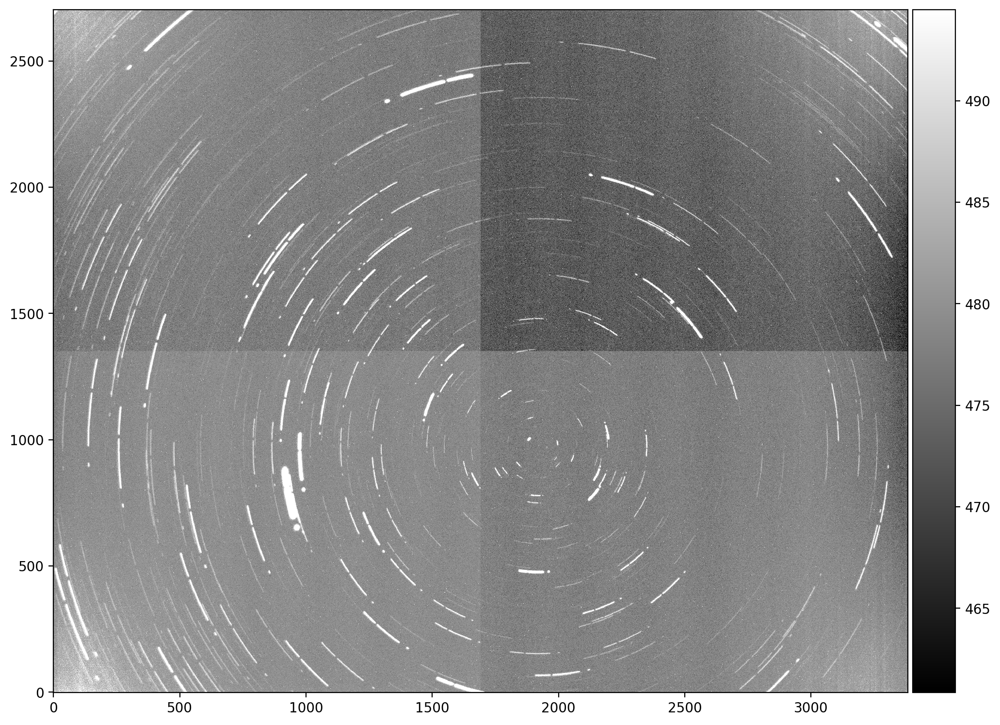

In [25]:
img = read_image('coadds/GenericCamera102-20230309-images1352-1512-coadd.fits')
display(img)

## High-Pass Filter

In [26]:
def apply_filter(A, smoothing, power=2.0):
    """Apply a hi/lo pass filter to a 2D image.
    
    The value of smoothing specifies the cutoff wavelength in pixels,
    with a value >0 (<0) applying a hi-pass (lo-pass) filter. The
    lo- and hi-pass filters sum to one by construction.  The power
    parameter determines the sharpness of the filter, with higher
    values giving a sharper transition.
    """
    if smoothing == 0:
        return A
    ny, nx = A.shape
    # Round down dimensions to even values for rfft.
    # Any trimmed row or column will be unfiltered in the output.
    nx = 2 * (nx // 2)
    ny = 2 * (ny // 2)
    T = np.fft.rfft2(A[:ny, :nx])
    # Last axis (kx) uses rfft encoding.
    kx = np.fft.rfftfreq(nx)
    ky = np.fft.fftfreq(ny)
    kpow = (kx ** 2 + ky[:, np.newaxis] ** 2) ** (power / 2.)
    k0pow = (1. / smoothing) ** power
    if smoothing > 0:
        F = kpow / (k0pow + kpow) # high pass
    else:
        F = k0pow / (k0pow + kpow) # low pass
    S = A.copy()
    S[:ny, :nx] = np.fft.irfft2(T * F)
    return S

/tmp/ipykernel_40051/415606623.py:1: DeprecationWarning: Please use `gaussian_filter` from the `scipy.ndimage` namespace, the `scipy.ndimage.filters` namespace is deprecated.
  from scipy.ndimage.filters import gaussian_filter


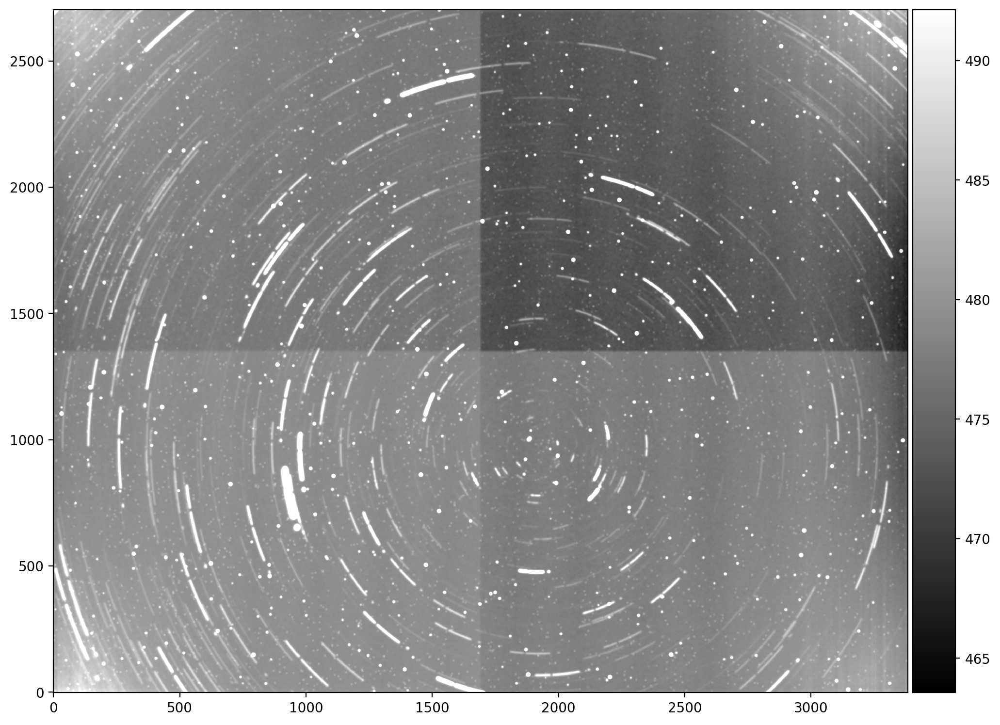

In [28]:
from scipy.ndimage.filters import gaussian_filter
img2 = gaussian_filter(img2, 3)
display(img2)

In [29]:
# from skimage.morphology import closing, dilation
# from skimage.morphology import disk

# footprint = disk(1)
# # img4 = dilation(img3, footprint)
# img4 = closing(img4, footprint)

# display(img4)

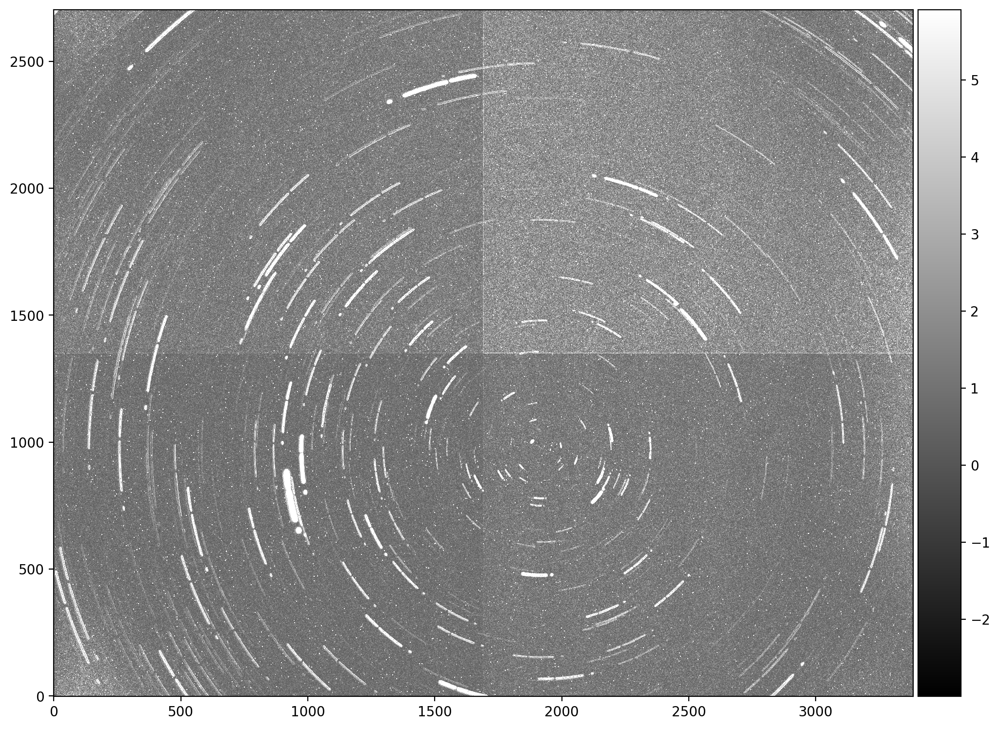

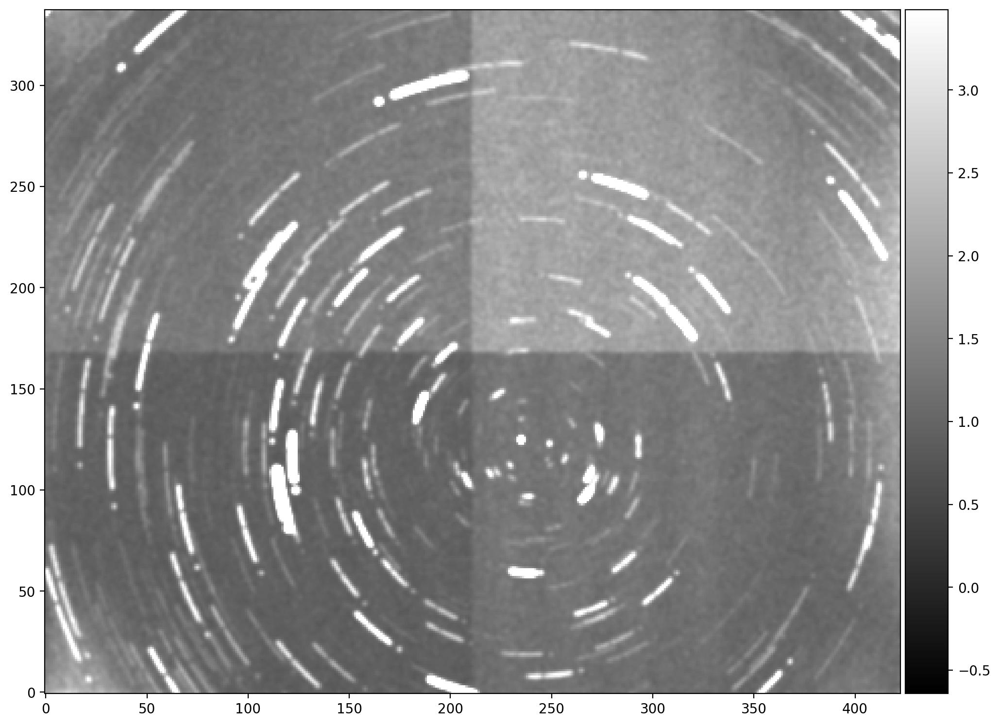

In [30]:
from skimage.measure import block_reduce
from skimage import filters

img1 = filters.sobel(img)
display(img1)

downscale = 8
img2 = gaussian_filter(block_reduce(img1, (downscale, downscale), func=np.nanmedian),1)
display(img2)

In [31]:
from photutils.datasets import make_4gaussians_image
from photutils.centroids import (centroid_1dg, centroid_2dg,
                                 centroid_com, centroid_quadratic)

downscale = 1
data = img1

x1, y1 = centroid_com(data)
x1, y1 = x1*downscale, y1*downscale
print((x1, y1))  

x2, y2 = centroid_quadratic(data)
x2, y2 = x2*downscale, y2*downscale
print((x2, y2))  

x3, y3 = centroid_1dg(data)
x3, y3 = x3*downscale, y3*downscale
print((x3, y3))  

# x4, y4 = centroid_2dg(data)
# x4, y4 = x4*downscale, y4*downscale
# print((x4, y4))

(1695.4586850502242, 1390.5831232547785)
(980.5989588209397, 1450.7099196262238)
(1570.7664133505566, 1704.553915047045)


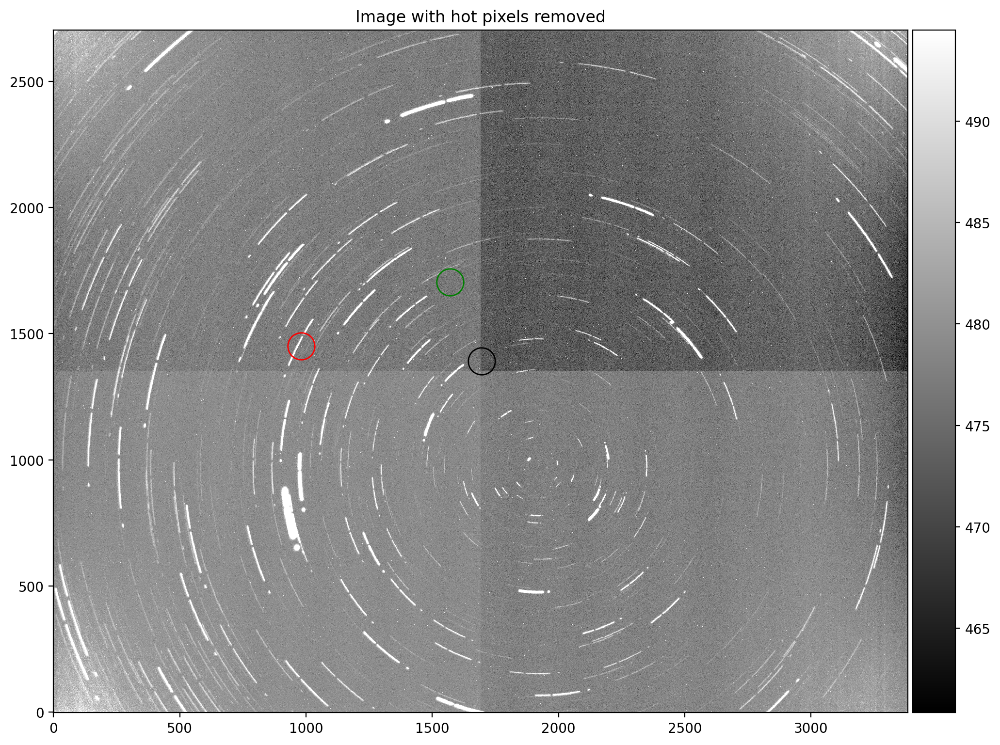

In [32]:
fig, (ax1) = plt.subplots(1,1, figsize=(12,12), sharex='all', sharey='all')

# ax1.axvspan(xmidle-10, xmidle+10, alpha=0.3, color='r')
# ax1.axhspan(ymidle-10, ymidle+10, alpha=0.3, color='r')

ax1.plot(x1,y1,'ro',mfc='none',mec='k',ms=20,label='Center')
ax1.plot(x2,y2,'ro',mfc='none',mec='r',ms=20,label='Center')
ax1.plot(x3,y3,'ro',mfc='none',mec='g',ms=20,label='Center')
# ax1.plot(x4,y4,'ro',mfc='none',mec='b',ms=20,label='Center')

ax1.set_title('Image with hot pixels removed')
display(img,ax=ax1)


In [33]:
from scipy.stats import binned_statistic_2d, binned_statistic
import scipy.optimize as opt

# Pixel coordinate grid

y2,x2 = np.mgrid[0:img2.shape[0], 0:img2.shape[1]]

xmax = int(img2.shape[0])
ymax = int(img2.shape[0])
xmid = int(xmax/2)
ymid = int(ymax/2)

mask = np.ones_like(img2)
mask[xmid-5:xmid+5,:] = np.nan
mask[:,ymid-5:ymid+5] = np.nan

def fn_detect(p):
    '''Estimator to locate tree rings center in downscaled images'''
    r = np.hypot(x2-p[0], y2-p[1])
    rmax = np.max(r)
    idx = np.isfinite(mask) & (img2 != 0)
    v,bins,_ = binned_statistic(r[idx], img2[idx], bins=np.arange(np.percentile(r,50), rmax, 1.0))
    return -np.std(v[np.isfinite(v)])

def signal(p):
    '''Estimator to locate tree rings center in downscaled images'''
    r = np.hypot(x2-p[0], y2-p[1])
    rmax = np.max(r)
    idx = np.isfinite(img2) & (img2 != 0)
    v,bins,_ = binned_statistic(r[idx], img2[idx], bins=np.arange(np.percentile(r,5), rmax, 1.0))
    return v, bins[1:]

In [34]:
# help(opt.differential_evolution)

In [35]:
xlow, xhig = 1300, 1600
ylow, yhig = 1300, 1500

cc = opt.differential_evolution(fn_detect,[[xlow/downscale,xhig/downscale],[ylow/downscale,yhig/downscale]], popsize=40, workers=40)
print(cc)

x0,y0 = cc.x[0]*downscale, cc.x[1]*downscale
print()
print("Original scale coordinates: %.2f, %.2f"%(x0, y0))

     fun: -0.647316031090712
 message: 'Optimization terminated successfully.'
    nfev: 563
     nit: 6
 success: True
       x: array([1595.6499875 , 1315.12791905])

Original scale coordinates: 1595.65, 1315.13


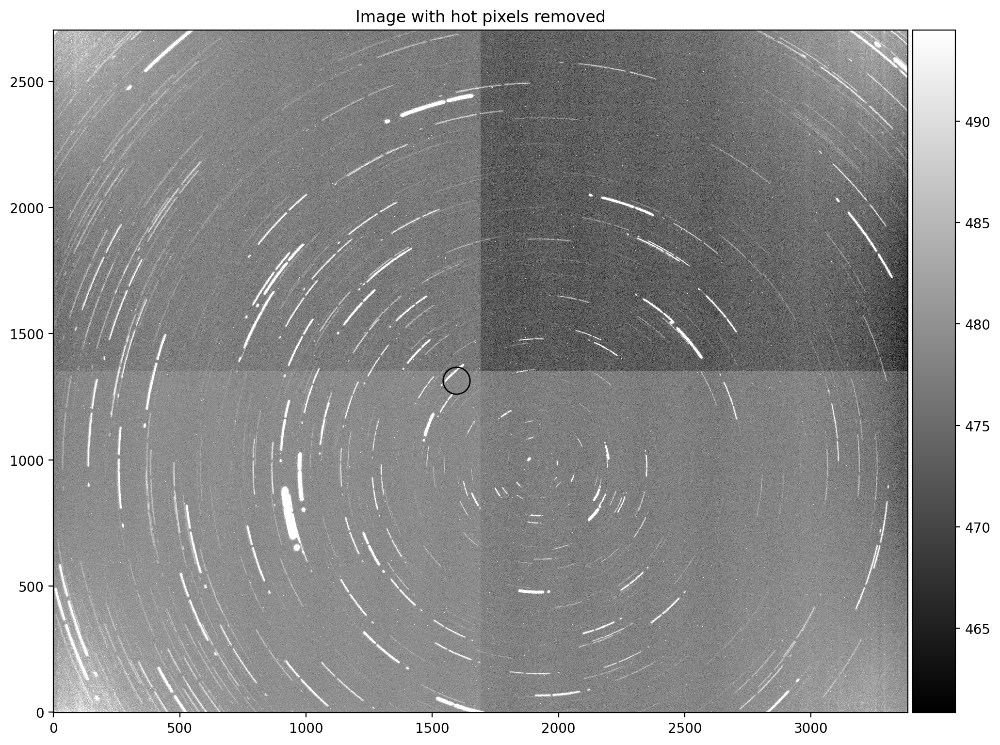

In [36]:
fig, (ax1) = plt.subplots(1,1, figsize=(12,12), sharex='all', sharey='all')

# ax1.axvspan(xmidle-10, xmidle+10, alpha=0.3, color='r')
# ax1.axhspan(ymidle-10, ymidle+10, alpha=0.3, color='r')
ax1.plot(x0,y0,'ro',mfc='none',mec='k',ms=20,label='Center')
ax1.set_title('Image with hot pixels removed')
display(img,ax=ax1)


In [ ]:
from scipy.ndimage.filters import gaussian_filter
img2 = gaussian_filter(img1, 1)
display(img2)

## Hot Pixels

Are the small pixels that saturates the image.

In [191]:
import scipy.ndimage

def find_outlier_pixels(data,tolerance=10,size=2):
    #This function finds the hot or dead pixels in a 2D dataset. 
    #tolerance is the number of standard deviations used to cutoff the hot pixels
    #If you want to ignore the edges and greatly speed up the code, then set
    #worry_about_edges to False.
    #
    #The function returns a list of hot pixels and also an image with with hot pixels removed
    from scipy.ndimage import median_filter
    blurred = median_filter(data, size=size)
    difference = data - blurred
    threshold = tolerance*np.std(difference)

    #find the hot pixels, but ignore the edges
    hot_pixels = np.nonzero((np.abs(difference[1:-1,1:-1])>threshold) )
    hot_pixels = np.array(hot_pixels) + 1 #because we ignored the first row and first column
    
    mean_value = np.nanmedian(data.flatten())
    
    fixed_image = np.copy(data) #This is the image with the hot pixels removed
    for y,x in zip(hot_pixels[0],hot_pixels[1]):
        fixed_image[y,x]= mean_value #blurred[y,x]
    
    mask = np.ones_like(img)
    mask[hot_pixels[0],hot_pixels[1]] = np.nan
    return fixed_image, mask, hot_pixels

In [192]:
fixed_image, mask, hot_pixels = find_outlier_pixels(img1, size=2, tolerance=20)

In [136]:
data = img1

In [143]:
from scipy.ndimage import median_filter
blurred = median_filter(data, size=2)
difference = (data - blurred)
difference_std = difference/np.nanstd(difference)

In [148]:
# display(blurred)

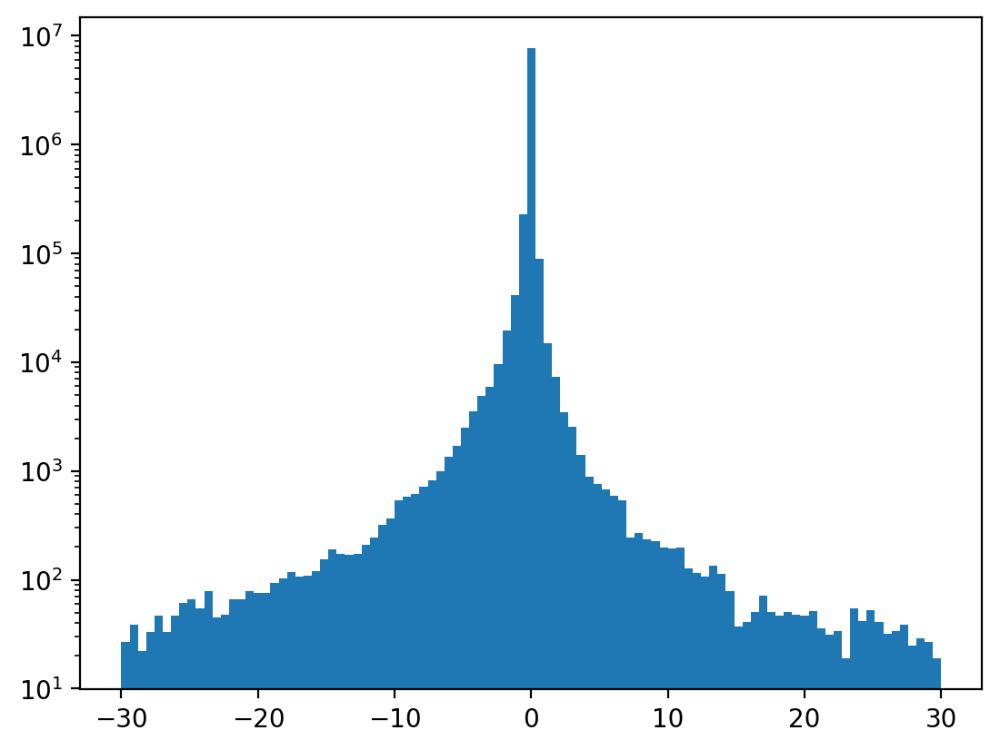

In [146]:
_ = plt.hist(difference_std.flatten(), bins=np.linspace(-30,30,100))
plt.yscale('log')

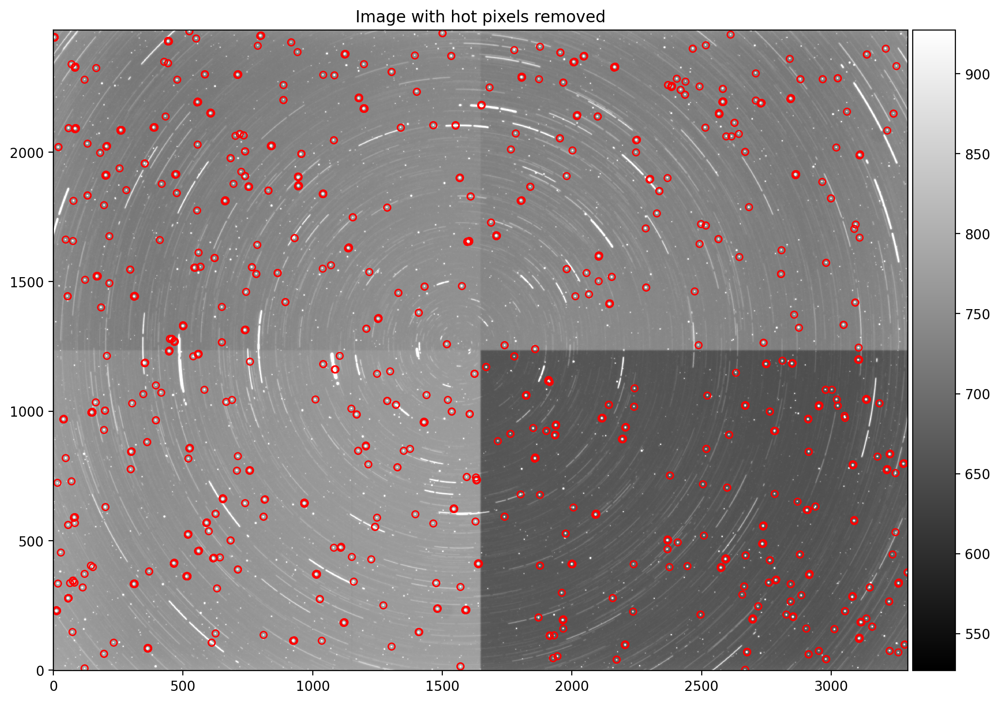

In [135]:
fig, (ax1) = plt.subplots(1,1, figsize=(12,12), sharex='all', sharey='all')

idx = np.random.randint(0, len(hot_pixels[0]), size=len(hot_pixels[0]))
for y,x in zip(hot_pixels[0][idx],hot_pixels[1][idx]):
    ax1.plot(x,y,'ro',mfc='none',mec='r',ms=5)

ax1.set_title('Image with hot pixels removed')
display(fixed_image,ax=ax1)

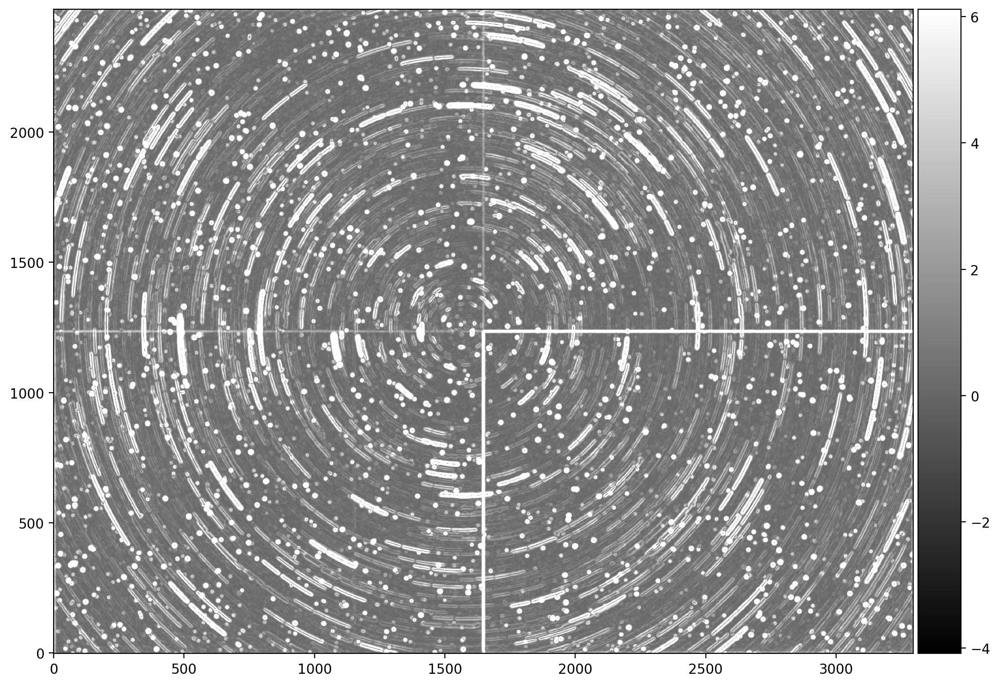

In [112]:
from skimage import filters
img3 = filters.sobel(img2)
display(img3)

## Make Stack Exposures

According to merlin's message:
https://lsstc.slack.com/archives/C041MQGD8HM/p1677190892331609

```
import os
from lsst.summit.utils.utils import starTrackerFileToExposure

startImage = 1352
nImages = 1512 - startImage

filenames = [f'/project/GenericCamera/103/2023/03/09/GC103_O_20230309_00{startImage+n:04}.fits' for n in range(nImages)]
filenames = [f for f in filenames if os.path.isfile(f)]

exp = starTrackerFileToExposure(filenames[0])
for file in filenames[1:]:
    temp = starTrackerFileToExposure(file)
    exp.image.array += temp.image.array
```

In [21]:
import os
from lsst.summit.utils.utils import starTrackerFileToExposure

startImage = 1352
nImages = 1512 - startImage
# nImages = 1354

filenames = [f'/project/GenericCamera/103/2023/03/09/GC103_O_20230309_00{startImage+n:04}.fits' for n in range(nImages)]
filenames = [f for f in filenames if os.path.isfile(f)]

exp = starTrackerFileToExposure(filenames[0])
for file in filenames[1:]:
    temp = starTrackerFileToExposure(file)
    exp.image.array += temp.image.array

## Packages

In [1]:
from lsst.summit.utils.astrometry import CommandLineSolver
from lsst.summit.utils.astrometry.utils import runCharactierizeImage, filterSourceCatOnBrightest
from lsst.summit.utils.utils import starTrackerFileToExposure

In [2]:
filename = '/project/GenericCamera/101/2023/02/22/GC101_O_20230222_000085.fits'

solver = CommandLineSolver('/project/shared/ref_cats/astrometry_net/')
exp = starTrackerFileToExposure(filename)

/opt/lsst/software/stack/stack/miniconda3-py38_4.9.2-5.1.0/Linux64/afw/g093c4c12c6+579e1af31e/python/lsst/afw/image/_visitInfo.py:62: FutureWarning: Call to deprecated method getExposureId. (Replaced by VisitInfo.id for full focal plane identifiers and by ExposureInfo.id for detector-level identifiers. Will be removed after v25.) -- Deprecated since version v24.0.
  exposureId = self.getExposureId()


In [3]:
charImageResult = runCharactierizeImage(exp, snr=5, minPix=25)

In [4]:
sources = filterSourceCatOnBrightest(charImageResult.sourceCat, 1)
result = solver.run(exp, sources, True)
print(result.wcs)
print(f"Astrometic scatter = {result.rmsErrorArsec:.02f} arcsec")
print(f"Astrometic scatter = {result.rmsErrorPixels:.02f} pixels")

Catalog had 3139 sources, of which 3134 were above 0.1% of max
Fitting image with 200 sources of which 200 made it into the fit
Fitting code ran in 2.16 seconds
FITS standard SkyWcs:
Sky Origin: (125.8176834939, +9.8597796767)
Pixel Origin: (1558.85, 1255.15)
Pixel Scale: 8.66442 arcsec/pixel
Astrometic scatter = 4.19 arcsec
Astrometic scatter = 0.48 pixels


In [5]:
!pip3 install opencv-python

Defaulting to user installation because normal site-packages is not writeable


In [6]:
from __future__ import print_function, unicode_literals, absolute_import, division
import sys
import numpy as np
import matplotlib
matplotlib.rcParams["image.interpolation"] = None
import matplotlib.pyplot as plt
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

/tmp/ipykernel_27311/4011289290.py:5: MatplotlibDeprecationWarning: Support for setting an rcParam that expects a str value to a non-str value is deprecated since 3.5 and support will be removed two minor releases later.
  matplotlib.rcParams["image.interpolation"] = None


In [7]:
def plot_img_label(img, img_title="image", lbl_title="label", **kwargs):
    fig, ai = plt.subplots(1,1, figsize=(12,5))
    im = ai.imshow(img, cmap='gray', clim=(0,1))
    ai.set_title(img_title)    
    fig.colorbar(im, ax=ai)

## Foreground/Background Segmentation

https://towardsdatascience.com/background-removal-with-python-b61671d1508a

In [8]:
import cv2
from astropy.io.fits import getdata
im = getdata('/home/adriansh95/DATA/starTracker/tmaTests/procFits/GC102_O_20221122_000042.fits')
# im = cv2.imread()

In [9]:
np.percentile(im.flatten(),[0, 25, 75,100])

array([    0.,   453.,   974., 16383.])

In [10]:
# Parameters
blur = 21
canny_low = 15
canny_high = 150
min_area = 0.0005
max_area = 0.95
dilate_iter = 10
erode_iter = 10
mask_color = (0.0,0.0,0.0)

In [11]:
# # Apply Canny Edge Dection
# edges = cv2.Canny(im, canny_low, canny_high)

In [12]:
def plot_img_label(img, lbl, img_title="image", lbl_title="edges", **kwargs):
    fig, (ai,al) = plt.subplots(1,2, figsize=(12,5), gridspec_kw=dict(width_ratios=(1.25,1)))
    im = ai.imshow(img, cmap='gray', clim=(0,1))
    ai.set_title(img_title)    
    fig.colorbar(im, ax=ai)
    al.imshow(lbl, cmap='gray')
    al.set_title(lbl_title)
    plt.tight_layout()

In [13]:
# plot_img_label(im, edges)

In [14]:
# get the contours and their areas
# contour_info = [(c, cv2.contourArea(c),) for c in cv2.findContours(edges, cv2.RETR_LIST, cv2.CHAIN_APPROX_NONE)[1]]

In [15]:
# plt.imshow(edges!=0)

In [16]:
# help(cv2.Canny)

In [17]:
# ls /home/adriansh95/DATA/starTracker/tmaTests/procFits/GC102_O_20221122_000042.fits

In [18]:
from astropy.io import fits
from scipy.stats import sigmaclip
from mpl_toolkits.axes_grid1 import make_axes_locatable

def display(imArr, nStd = 5, gSig = 7):
    fig, ax = plt.subplots(1,1, figsize=(12,12))
    imArrClip, low, high = sigmaclip(imArr)
    mean = imArrClip.mean()
    std = imArrClip.std()
    im = ax.imshow(imArr, vmin=mean-nStd*std, vmax=mean+nStd*std, cmap='gray')
    divider = make_axes_locatable(ax)
    cax = divider.append_axes('right', size='5%', pad=0.05)
    fig.colorbar(im, cax=cax, orientation='vertical')

    plt.show()
    cax.cla()
    fig.savefig('test.png',dpi=125)

def read_image(filename):
    with fits.open(filename) as hdu:
        imArr = hdu[1].data
    return imArr

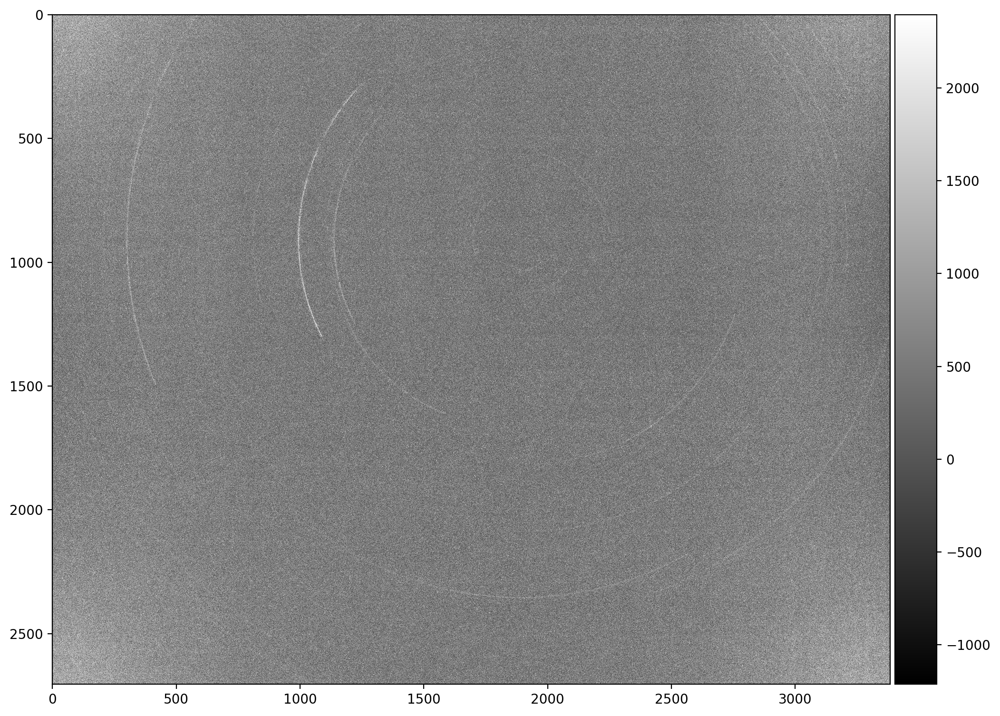

In [ ]:
im = read_image('/home/adriansh95/DATA/starTracker/tmaTests/procFits/GC102_O_20221122_000041.fits')
display(im)

In [ ]:
def apply_filter(A, smoothing, power=2.0):
    """Apply a hi/lo pass filter to a 2D image.
    
    The value of smoothing specifies the cutoff wavelength in pixels,
    with a value >0 (<0) applying a hi-pass (lo-pass) filter. The
    lo- and hi-pass filters sum to one by construction.  The power
    parameter determines the sharpness of the filter, with higher
    values giving a sharper transition.
    """
    if smoothing == 0:
        return A
    ny, nx = A.shape
    # Round down dimensions to even values for rfft.
    # Any trimmed row or column will be unfiltered in the output.
    nx = 2 * (nx // 2)
    ny = 2 * (ny // 2)
    T = np.fft.rfft2(A[:ny, :nx])
    # Last axis (kx) uses rfft encoding.
    kx = np.fft.rfftfreq(nx)
    ky = np.fft.fftfreq(ny)
    kpow = (kx ** 2 + ky[:, np.newaxis] ** 2) ** (power / 2.)
    k0pow = (1. / smoothing) ** power
    if smoothing > 0:
        F = kpow / (k0pow + kpow) # high pass
    else:
        F = k0pow / (k0pow + kpow) # low pass
    S = A.copy()
    S[:ny, :nx] = np.fft.irfft2(T * F)
    return S

In [ ]:
img1 = apply_filter(im, -10)
# img2 = apply_filter(img1, -1)

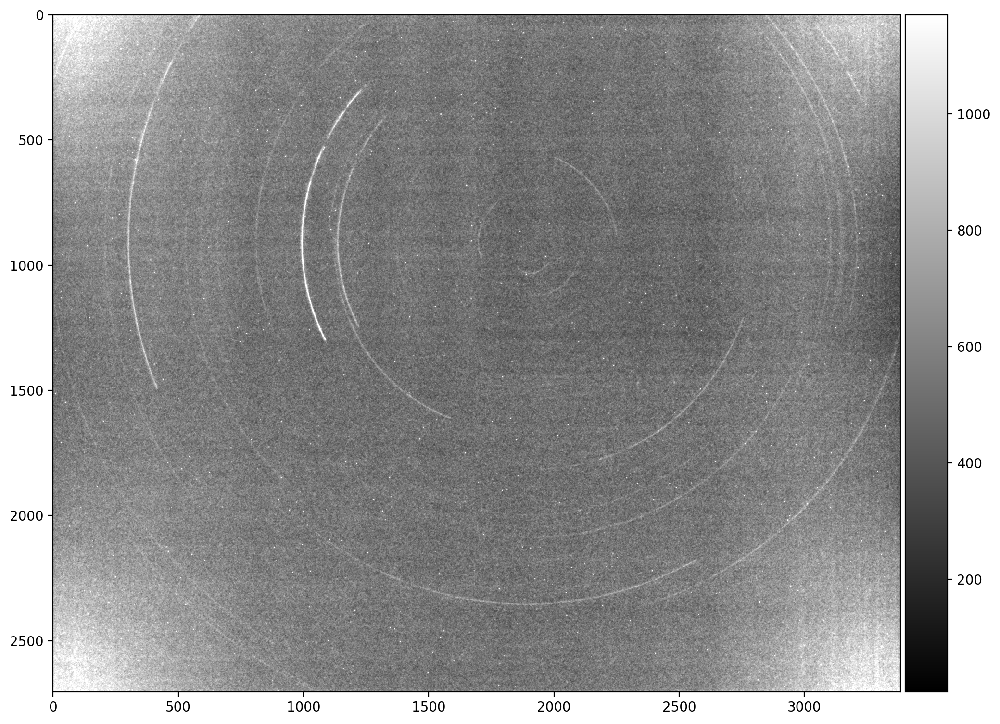

In [ ]:
display(img1)

/tmp/ipykernel_27311/1866465634.py:1: DeprecationWarning: Please use `gaussian_filter` from the `scipy.ndimage` namespace, the `scipy.ndimage.filters` namespace is deprecated.
  from scipy.ndimage.filters import gaussian_filter


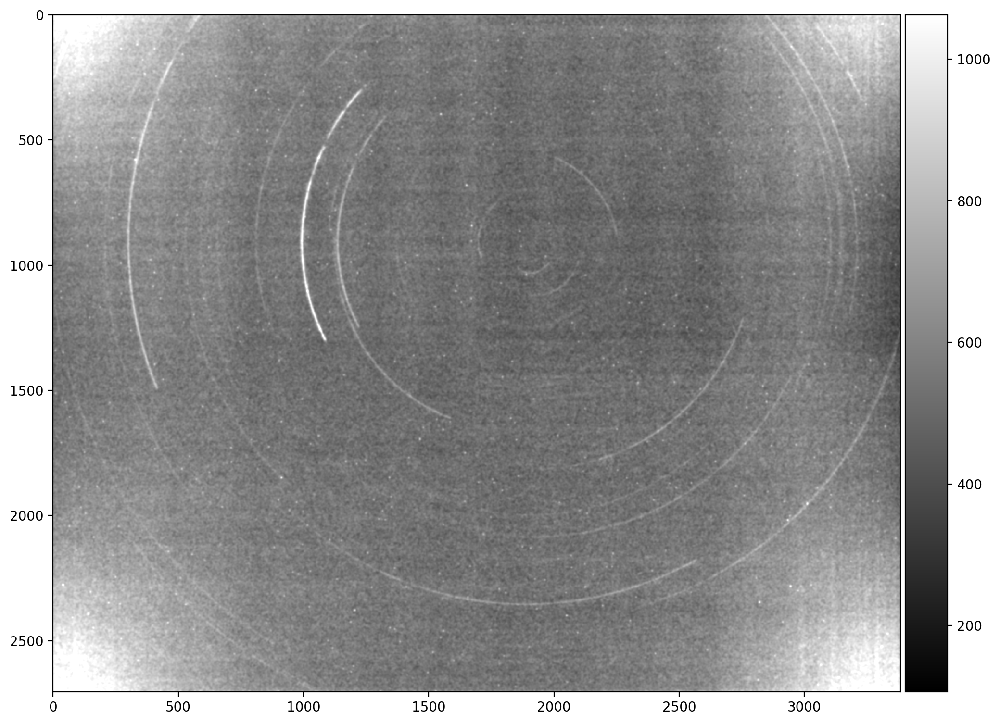

In [ ]:
from scipy.ndimage.filters import gaussian_filter
img2 = gaussian_filter(img1, 3)
display(img2)

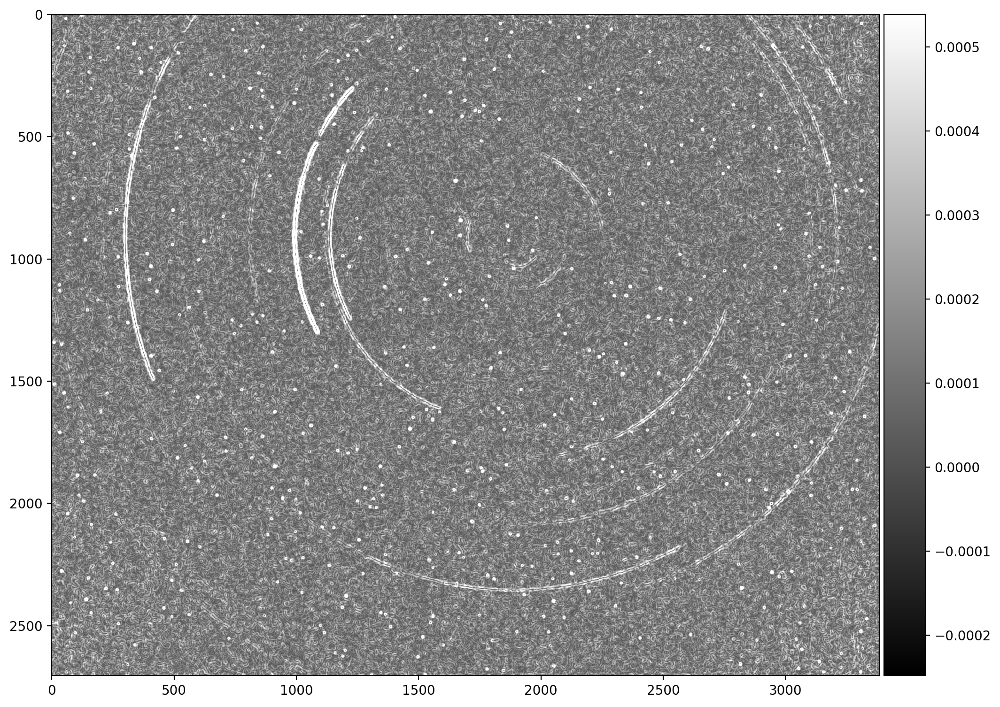

In [43]:
from skimage import filters
img3 = filters.sobel(img2)
display(img3)

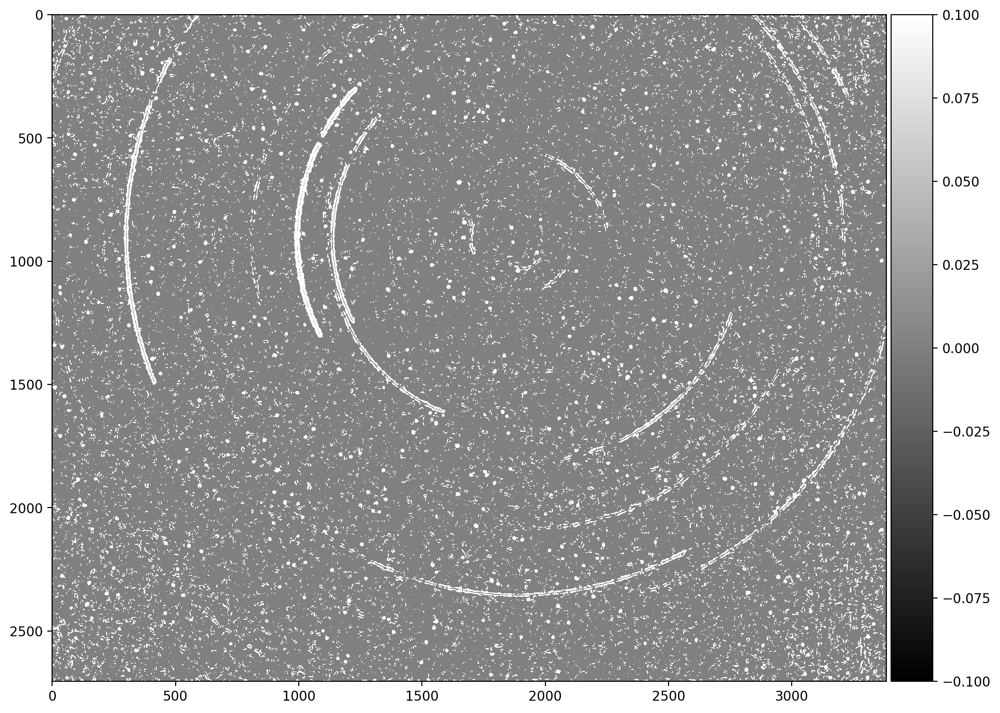

In [50]:
from skimage.filters import threshold_otsu, rank
from scipy import ndimage as ndi

thresh = threshold_otsu(img3)
# local_otsu = rank.otsu(img, footprint)

mask = img3 > 1.5*thresh
img4 = ndi.distance_transform_edt(mask)
display(img4)

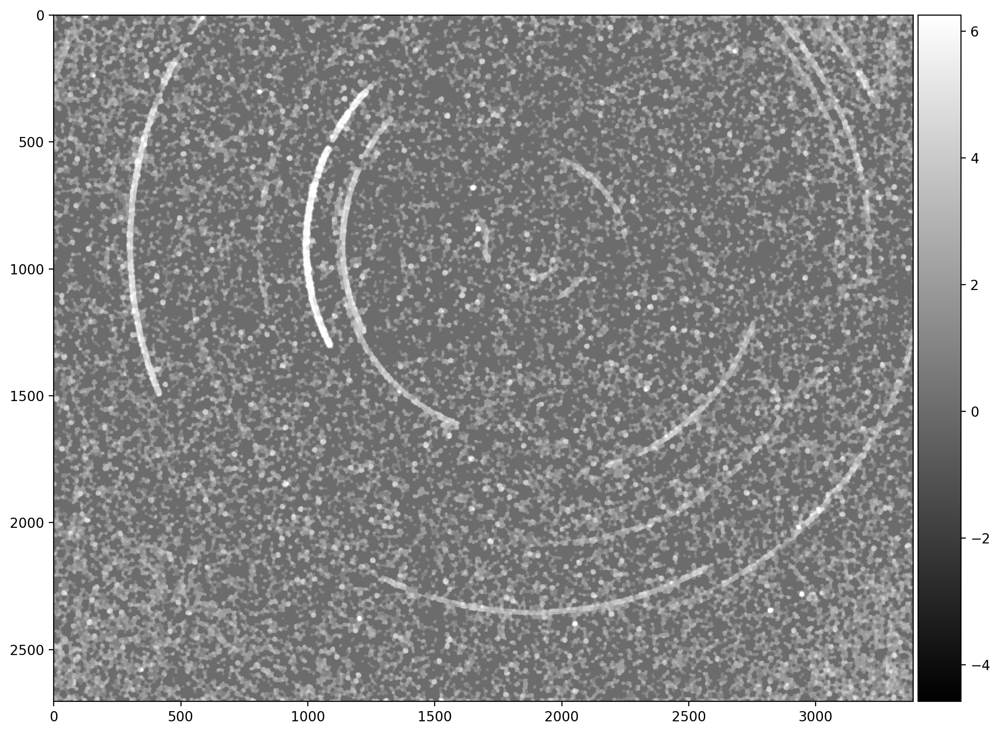

In [51]:
from skimage.morphology import closing, dilation
from skimage.morphology import disk

footprint = disk(5)
img5 = dilation(img4, footprint)
img5 = closing(img5, footprint)

display(img5)

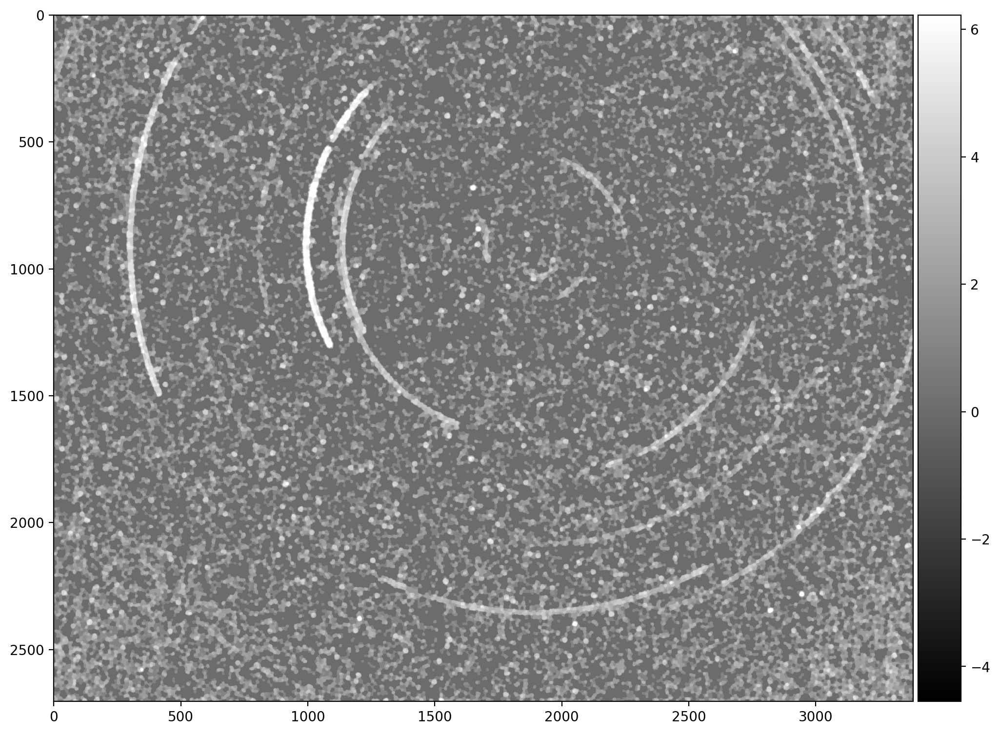

In [59]:
img6 = apply_filter(img5, -1.5)
display(img6)

/tmp/ipykernel_27311/1256869923.py:3: DeprecationWarning: Please use `label` from the `scipy.ndimage` namespace, the `scipy.ndimage.measurements` namespace is deprecated.
  labelarray, particle_count = ndimage.measurements.label(img5l)


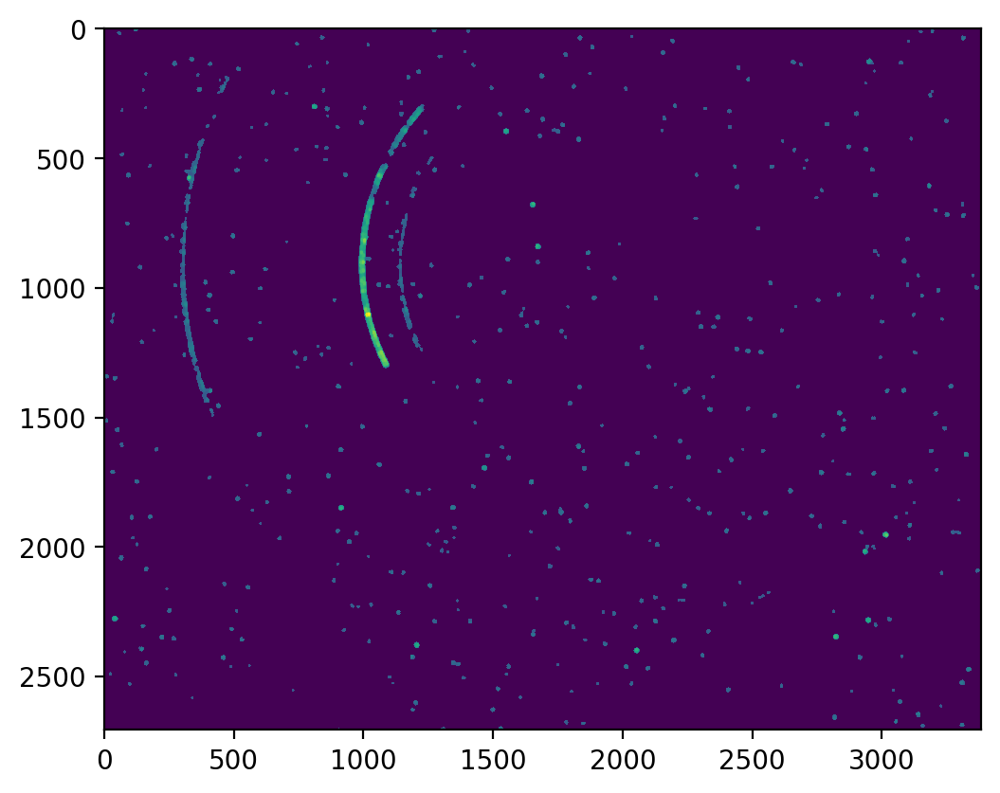

In [ ]:
from scipy import ndimage
img5l = np.where(img5>0.3*np.max(img5), img5.copy(), np.min(img5))
labelarray, particle_count = ndimage.measurements.label(img5l)
img6 = np.where(~labelarray, img5l.copy(), 0)
plt.imshow(img5l)

In [ ]:
# help(scipy.ndimage.measurements.label)

In [ ]:
labelarray

array([[1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       ...,
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1]], dtype=int32)

In [ ]:
# from sklearn.decomposition import PCA
# pca = PCA(100)
# img_transformed = pca.fit_transform(im)
# img_inverted = pca.inverse_transform(img_transformed)


In [ ]:
# display(img_inverted)

In [ ]:
img_compressed = (np.dstack((red_inverted, red_inverted, red_inverted))).astype(np.uint8)


NameError: name 'red_inverted' is not defined

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy import ndimage as ndi
from skimage.util import random_noise
from skimage import feature

image = ndi.gaussian_filter(-img2, 1)
image = random_noise(image, mode='speckle', mean=0.1)

# Compute the Canny filter for two values of sigma
edges1 = feature.canny(image)
edges2 = feature.canny(image, sigma=3)

# display results
fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(8, 3))

ax[0].imshow(image, cmap='gray')
ax[0].set_title('noisy image', fontsize=20)

ax[1].imshow(edges1, cmap='gray')
ax[1].set_title(r'Canny filter, $\sigma=1$', fontsize=20)

ax[2].imshow(edges2, cmap='gray')
ax[2].set_title(r'Canny filter, $\sigma=3$', fontsize=20)

for a in ax:
    a.axis('off')

fig.tight_layout()
plt.show()

In [ ]:
np.percentile(im.flatten(), [50, 75, 95])

In [ ]:
# Apply Canny Edge Dection
im_copy = np.uint8(img)
edges = cv2.Canny(im_copy,150,500)
plt.imshow(edges)

In [ ]:
im_copy

In [ ]:
img.shape

In [ ]:
# img = np.expand_dims(im, axis=0)
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
edges = cv2.Canny(gray, 70, 110, apertureSize=3)
# and so on
lines = cv2.HoughLines(edges, 1, np.pi / 180, 150)

In [ ]:
debayered_image = cv2.cvtColor(im, cv2.COLOR_GR)


In [ ]:
im = cv2.imread('test.png', cv2.IMREAD_GRAYSCALE)
# im = im_copy
canny_low = 150
canny_high = 500

blur = cv2.blur(im,(10,10))

edges = cv2.Canny(im, canny_low, canny_high)
plt.imshow(edges)

In [ ]:
display(blur)

In [ ]:
cv2.blur(im, 50)

In [ ]:
fig, ax = plt.subplots(figsize=(10, 10))
print(filename)
ax.cla()

with fits.open(filename) as hdu:
    imArr = hdu[1].data
    imArrClip, low, high = sigmaclip(imArr)
    mean = imArrClip.mean()
    std = imArrClip.std()
    im = ax.imshow(imArr, vmin=mean-nStd*std, vmax=mean+nStd*std)
    divider = make_axes_locatable(ax)
    cax = divider.append_axes('right', size='5%', pad=0.05)
    fig.colorbar(im, cax=cax, orientation='vertical')
        
plt.show()